In [2]:
# THIS TAKES A LONG TIME TO LOAD, JUST USE PICKLE FILES

# # load clean and gaussian data
# import os
# import numpy as np
# from PIL import Image

# directory = "./drive/MyDrive/566 Project/data/gaussian_noise"

# total_files = 0
# stop = 1000 # number of files to load. prohibitively long to load everything

# def pic_id(fn):
#     return fn.split("_")[2].split(".")[0]

# noise = {}
# for dirname in os.listdir(directory):
#     if dirname == ".DS_Store": continue
#     dir_ = os.path.join(directory, dirname)
#     for subdir in os.listdir(dir_):
#         if subdir == ".DS_Store": continue
#         subsubdir = os.path.join(dir_, subdir)
#         for subfile in os.listdir(subsubdir):
#             if subfile == ".DS_Store": continue
#             if total_files == stop: break
#             total_files += 1
#             print(total_files)
#             path_ = os.path.join(subsubdir, subfile)
#             img = Image.open(path_)
#             noise[pic_id(subfile)] = np.asanyarray(img)

# directory = "./drive/MyDrive/566 Project/data/clean"

# total_files = 0

# clean = {}
# for fn in os.listdir(directory):
#     if total_files == stop: break
#     if fn == ".DS_Store": continue
#     subdir = os.path.join(directory, fn)
#     total_files += 1
#     img = Image.open(subdir)
#     clean[pic_id(fn)] = np.asanyarray(img)

In [1]:
from tqdm import tqdm
import sys
path = "../"
if 'google.colab' in sys.modules:
    print('Running in Colab.')
    path = "./drive/MyDrive/566 Project"
    from google.colab import drive
    drive.mount('/content/drive')

In [2]:
%%capture
!pip install transformers
import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms

In [3]:
import pickle as pkl 

# match adversarial image (input) with clean image (target)

# had to split up pickle files for size

# data = [] # [[adv_0, clean_0], ..., [adv_k, clean_k]]

data = open(path+"data/data1_cropped_name", 'rb')
data1 = pkl.load(data)
data = open(path+"data/data2_cropped_name", 'rb')
data2 = pkl.load(data)
# data = open(path+"data/adv_cropped_name.pkl", 'rb')
# data = pkl.load(data)
# len(data1) + len(data2)

In [4]:
unprocessed_data = (data1 + data2)
# unprocessed_data = data
print(len(unprocessed_data))

17993


In [5]:
# pretrained MAE model and image processor

import transformers
from transformers import ViTMAEForPreTraining, AutoImageProcessor

image_processor = AutoImageProcessor.from_pretrained('facebook/vit-mae-base')
model = ViTMAEForPreTraining.from_pretrained('facebook/vit-mae-base')

In [6]:
data = []
for i in range(len(unprocessed_data)):
  name, n,c = unprocessed_data[i]
  if len(n.shape) == 3 and len(c.shape) == 3: 
    n = image_processor(images=n, return_tensors="pt")
    c = image_processor(images=c, return_tensors="pt")
    data.append([name, n,c])
  

In [7]:
del unprocessed_data, data1, data2

In [8]:
# load data into dataset object for dataloader
class DS(Dataset):
     def __init__(self, data):
         super(Dataset, self).__init__()
         self.data = data
        
     def __len__(self):
         return len(data)
        
     def __getitem__(self, index):
        # print(self.__len__() , index)
        assert self.__len__() > index
        return self.data[index][1], self.data[index][2]
    
     def getname(self, index):
        assert self.__len__() > index
        return self.data[index][0]


ds = DS(data)
train_size = int(0.9 * len(ds)) # 90- 10 split... should change this later
test_size = len(ds) - train_size
train_dataset, test_dataset = torch.utils.data.random_split(ds, [train_size, test_size])

train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=True)

In [9]:
del ds, train_dataset, test_dataset # save RAM

In [28]:
# checkpoint_path = './drive/MyDrive/566 Project/checkpoints/'

# def prepare_model(model, chkpt_dir,):
#     # build model
#     checkpoint = torch.load(chkpt_dir, map_location='cpu')
#     msg = model.load_state_dict(checkpoint['model'], strict=False)
#     return model

# # load model checkpoint 
# model = prepare_model(model, checkpoint_path +'mae_visualize_vit_large_ganloss.pth')


In [29]:
# the forward pass runs through the encoder, decoder, and forward loss, which compares the output to the actual image.
# we're going to ignore the OG preturbed and compare it to the purified one

# same as og model but added here for reference... https://github.com/facebookresearch/mae/blob/main/models_mae.py

'''
def forward_loss(self, imgs, pred, mask):
        """
        imgs: [N, 3, H, W]
        pred: [N, L, p*p*3]
        mask: [N, L], 0 is keep, 1 is remove, 
        """
        target = self.patchify(imgs)
        if self.norm_pix_loss:
            mean = target.mean(dim=-1, keepdim=True)
            var = target.var(dim=-1, keepdim=True)
            target = (target - mean) / (var + 1.e-6)**.5

        loss = (pred - target) ** 2 # COULD TRY BCELOSS
        loss = loss.mean(dim=-1)  # [N, L], mean loss per patch

        loss = (loss * mask).sum() / mask.sum()  # mean loss on removed patches
        return loss
'''


'\ndef forward_loss(self, imgs, pred, mask):\n        """\n        imgs: [N, 3, H, W]\n        pred: [N, L, p*p*3]\n        mask: [N, L], 0 is keep, 1 is remove, \n        """\n        target = self.patchify(imgs)\n        if self.norm_pix_loss:\n            mean = target.mean(dim=-1, keepdim=True)\n            var = target.var(dim=-1, keepdim=True)\n            target = (target - mean) / (var + 1.e-6)**.5\n\n        loss = (pred - target) ** 2 # COULD TRY BCELOSS\n        loss = loss.mean(dim=-1)  # [N, L], mean loss per patch\n\n        loss = (loss * mask).sum() / mask.sum()  # mean loss on removed patches\n        return loss\n'

In [31]:
from torch import optim, nn

checkpoint_path = path+'checkpoints/'

device = torch.device("cuda") 

# model params
epochs = 100
learning_rate = 1e-4
model.to(device)
model = model.train() 

# build optimizer 
optimizer = optim.AdamW(model.parameters(), lr=learning_rate)

#################################### END TODO #######################################

train_it = 0
rec_loss = 0
batch_size = 32
in_size = out_size = 224
track_loss = []
for ep in range(epochs):
  print("Run Epoch {}".format(ep))

  for adv, clean_ in tqdm(train_dataloader): # loads a batch of data
    batch_size = adv.pixel_values.size()[0] # should be 8 unless at the very end of the dataloader

    inputs = adv.pixel_values.view(batch_size,3,224,224).to(device)

    clean_ = clean_.pixel_values.view(batch_size,3,224,224).to(device)

    optimizer.zero_grad()

    outputs = model(inputs) # dictionary w/ loss, logits, mask, ids_restore

    loss = model.forward_loss(clean_, outputs["logits"], outputs["mask"])

    if train_it % 10 == 0:
        track_loss.append(loss)

    # print(loss)
    
    loss.backward()

    optimizer.step()

    if train_it % 500 == 0:
      print("It {}: Reconstruction Loss: {}".format(train_it, loss))
      model.save_pretrained(checkpoint_path) # save at end of epoch
    train_it += 1
    

print("Done!")


Run Epoch 0


  0%|          | 0/385 [00:00<?, ?it/s]

It 0: Reconstruction Loss: 0.3756507635116577


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 1


 30%|██▉       | 115/385 [01:16<02:59,  1.50it/s]

It 500: Reconstruction Loss: 0.2620324492454529


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 2


 60%|█████▉    | 230/385 [02:33<01:46,  1.45it/s]

It 1000: Reconstruction Loss: 0.30818986892700195


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 3


 90%|████████▉ | 345/385 [03:50<00:26,  1.50it/s]

It 1500: Reconstruction Loss: 0.36791175603866577


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 4


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 5


 19%|█▉        | 75/385 [00:50<03:25,  1.51it/s]

It 2000: Reconstruction Loss: 0.3243815004825592


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 6


 49%|████▉     | 190/385 [02:07<02:10,  1.50it/s]

It 2500: Reconstruction Loss: 0.2928246259689331


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 7


 79%|███████▉  | 305/385 [03:23<00:53,  1.50it/s]

It 3000: Reconstruction Loss: 0.351151704788208


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 8


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 9


  9%|▉         | 35/385 [00:23<03:52,  1.50it/s]

It 3500: Reconstruction Loss: 0.3508322536945343


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 10


 39%|███▉      | 150/385 [01:40<02:36,  1.50it/s]

It 4000: Reconstruction Loss: 0.2906445860862732


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 11


 69%|██████▉   | 265/385 [02:57<01:20,  1.50it/s]

It 4500: Reconstruction Loss: 0.2733166813850403


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 12


 99%|█████████▊| 380/385 [04:14<00:03,  1.50it/s]

It 5000: Reconstruction Loss: 0.34035009145736694


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 13


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 14


 29%|██▊       | 110/385 [01:13<03:03,  1.50it/s]

It 5500: Reconstruction Loss: 0.3190244734287262


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 15


 58%|█████▊    | 225/385 [02:30<01:46,  1.51it/s]

It 6000: Reconstruction Loss: 0.29246488213539124


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 16


 88%|████████▊ | 340/385 [03:47<00:30,  1.49it/s]

It 6500: Reconstruction Loss: 0.29605695605278015


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 17


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 18


 18%|█▊        | 70/385 [00:46<03:29,  1.50it/s]

It 7000: Reconstruction Loss: 0.3439321219921112


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 19


 48%|████▊     | 185/385 [02:03<02:13,  1.50it/s]

It 7500: Reconstruction Loss: 0.2709803581237793


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 20


 78%|███████▊  | 300/385 [03:21<00:57,  1.48it/s]

It 8000: Reconstruction Loss: 0.26785990595817566


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 21


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 22


  8%|▊         | 30/385 [00:20<03:57,  1.50it/s]

It 8500: Reconstruction Loss: 0.30674484372138977


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 23


 38%|███▊      | 145/385 [01:37<02:40,  1.50it/s]

It 9000: Reconstruction Loss: 0.22434546053409576


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 24


 68%|██████▊   | 260/385 [02:53<01:23,  1.50it/s]

It 9500: Reconstruction Loss: 0.31240156292915344


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 25


 97%|█████████▋| 375/385 [04:10<00:06,  1.50it/s]

It 10000: Reconstruction Loss: 0.29556000232696533


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 26


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 27


 27%|██▋       | 105/385 [01:10<03:06,  1.50it/s]

It 10500: Reconstruction Loss: 0.28850674629211426


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 28


 57%|█████▋    | 220/385 [02:26<01:49,  1.50it/s]

It 11000: Reconstruction Loss: 0.29276758432388306


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 29


 87%|████████▋ | 335/385 [03:44<00:33,  1.50it/s]

It 11500: Reconstruction Loss: 0.29326486587524414


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 30


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 31


 17%|█▋        | 65/385 [00:43<03:33,  1.50it/s]

It 12000: Reconstruction Loss: 0.3005002737045288


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 32


 47%|████▋     | 180/385 [02:00<02:16,  1.50it/s]

It 12500: Reconstruction Loss: 0.31152117252349854


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 33


 77%|███████▋  | 295/385 [03:17<01:00,  1.50it/s]

It 13000: Reconstruction Loss: 0.28507035970687866


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 34


100%|██████████| 385/385 [04:16<00:00,  1.50it/s]


Run Epoch 35


  6%|▋         | 25/385 [00:16<04:01,  1.49it/s]

It 13500: Reconstruction Loss: 0.2707321345806122


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 36


 36%|███▋      | 140/385 [01:33<02:42,  1.51it/s]

It 14000: Reconstruction Loss: 0.28786858916282654


100%|██████████| 385/385 [04:20<00:00,  1.48it/s]


Run Epoch 37


 66%|██████▌   | 255/385 [02:50<01:26,  1.50it/s]

It 14500: Reconstruction Loss: 0.2535076439380646


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 38


 96%|█████████▌| 370/385 [04:07<00:10,  1.44it/s]

It 15000: Reconstruction Loss: 0.24556991457939148


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 39


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 40


 26%|██▌       | 100/385 [01:06<03:09,  1.50it/s]

It 15500: Reconstruction Loss: 0.3264862298965454


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 41


 56%|█████▌    | 215/385 [02:24<01:53,  1.50it/s]

It 16000: Reconstruction Loss: 0.3365018665790558


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 42


 86%|████████▌ | 330/385 [03:40<00:36,  1.50it/s]

It 16500: Reconstruction Loss: 0.2629706561565399


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 43


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 44


 16%|█▌        | 60/385 [00:40<03:36,  1.50it/s]

It 17000: Reconstruction Loss: 0.24768564105033875


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 45


 45%|████▌     | 175/385 [01:56<02:20,  1.50it/s]

It 17500: Reconstruction Loss: 0.28601858019828796


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 46


 75%|███████▌  | 290/385 [03:14<01:03,  1.50it/s]

It 18000: Reconstruction Loss: 0.27150335907936096


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 47


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 48


  5%|▌         | 20/385 [00:13<04:02,  1.50it/s]

It 18500: Reconstruction Loss: 0.2698170244693756


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 49


 35%|███▌      | 135/385 [01:30<02:46,  1.50it/s]

It 19000: Reconstruction Loss: 0.26918840408325195


100%|██████████| 385/385 [04:20<00:00,  1.48it/s]


Run Epoch 50


 65%|██████▍   | 250/385 [02:46<01:29,  1.50it/s]

It 19500: Reconstruction Loss: 0.2866574227809906


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 51


 95%|█████████▍| 365/385 [04:03<00:13,  1.50it/s]

It 20000: Reconstruction Loss: 0.2904919981956482


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 52


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 53


 25%|██▍       | 95/385 [01:03<03:20,  1.45it/s]

It 20500: Reconstruction Loss: 0.289920836687088


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 54


 55%|█████▍    | 210/385 [02:19<01:56,  1.50it/s]

It 21000: Reconstruction Loss: 0.28001710772514343


100%|██████████| 385/385 [04:20<00:00,  1.48it/s]


Run Epoch 55


 84%|████████▍ | 325/385 [03:37<00:40,  1.50it/s]

It 21500: Reconstruction Loss: 0.24189257621765137


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 56


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 57


 14%|█▍        | 55/385 [00:36<03:40,  1.50it/s]

It 22000: Reconstruction Loss: 0.26947474479675293


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 58


 44%|████▍     | 170/385 [01:53<02:23,  1.50it/s]

It 22500: Reconstruction Loss: 0.278558611869812


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 59


 74%|███████▍  | 285/385 [03:10<01:06,  1.50it/s]

It 23000: Reconstruction Loss: 0.27648597955703735


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 60


100%|██████████| 385/385 [04:16<00:00,  1.50it/s]


Run Epoch 61


  4%|▍         | 15/385 [00:09<04:05,  1.50it/s]

It 23500: Reconstruction Loss: 0.2637769877910614


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 62


 34%|███▍      | 130/385 [01:26<02:49,  1.50it/s]

It 24000: Reconstruction Loss: 0.24070075154304504


100%|██████████| 385/385 [04:20<00:00,  1.48it/s]


Run Epoch 63


 64%|██████▎   | 245/385 [02:44<01:33,  1.50it/s]

It 24500: Reconstruction Loss: 0.30867108702659607


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 64


 94%|█████████▎| 360/385 [04:00<00:16,  1.50it/s]

It 25000: Reconstruction Loss: 0.24671204388141632


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 65


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 66


 23%|██▎       | 90/385 [01:00<03:16,  1.50it/s]

It 25500: Reconstruction Loss: 0.24843114614486694


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 67


 53%|█████▎    | 205/385 [02:16<02:01,  1.49it/s]

It 26000: Reconstruction Loss: 0.25221025943756104


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 68


 83%|████████▎ | 320/385 [03:34<00:43,  1.50it/s]

It 26500: Reconstruction Loss: 0.26761165261268616


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 69


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 70


 13%|█▎        | 50/385 [00:33<03:43,  1.50it/s]

It 27000: Reconstruction Loss: 0.3369715213775635


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 71


 43%|████▎     | 165/385 [01:49<02:26,  1.50it/s]

It 27500: Reconstruction Loss: 0.2885766625404358


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 72


 73%|███████▎  | 280/385 [03:07<01:10,  1.50it/s]

It 28000: Reconstruction Loss: 0.22316767275333405


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 73


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 74


  3%|▎         | 10/385 [00:06<04:10,  1.50it/s]

It 28500: Reconstruction Loss: 0.2859790325164795


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 75


 32%|███▏      | 125/385 [01:23<02:53,  1.50it/s]

It 29000: Reconstruction Loss: 0.24831092357635498


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 76


 62%|██████▏   | 240/385 [02:40<01:36,  1.50it/s]

It 29500: Reconstruction Loss: 0.2473095804452896


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 77


 92%|█████████▏| 355/385 [03:57<00:20,  1.50it/s]

It 30000: Reconstruction Loss: 0.2868633270263672


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 78


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 79


 22%|██▏       | 85/385 [00:56<03:19,  1.50it/s]

It 30500: Reconstruction Loss: 0.2240433394908905


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 80


 52%|█████▏    | 200/385 [02:13<02:03,  1.49it/s]

It 31000: Reconstruction Loss: 0.2535356879234314


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 81


 82%|████████▏ | 315/385 [03:30<00:47,  1.48it/s]

It 31500: Reconstruction Loss: 0.24552252888679504


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 82


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 83


 12%|█▏        | 45/385 [00:30<03:47,  1.50it/s]

It 32000: Reconstruction Loss: 0.2546139061450958


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 84


 42%|████▏     | 160/385 [01:46<02:30,  1.50it/s]

It 32500: Reconstruction Loss: 0.24790306389331818


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 85


 71%|███████▏  | 275/385 [03:04<01:16,  1.45it/s]

It 33000: Reconstruction Loss: 0.27960851788520813


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 86


100%|██████████| 385/385 [04:17<00:00,  1.49it/s]


Run Epoch 87


  1%|▏         | 5/385 [00:03<04:12,  1.51it/s]

It 33500: Reconstruction Loss: 0.2592257857322693


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 88


 31%|███       | 120/385 [01:20<02:57,  1.50it/s]

It 34000: Reconstruction Loss: 0.31822657585144043


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 89


 61%|██████    | 235/385 [02:36<01:39,  1.51it/s]

It 34500: Reconstruction Loss: 0.2351643294095993


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 90


 91%|█████████ | 350/385 [03:54<00:23,  1.50it/s]

It 35000: Reconstruction Loss: 0.2938605546951294


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 91


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 92


 21%|██        | 80/385 [00:53<03:22,  1.50it/s]

It 35500: Reconstruction Loss: 0.26234009861946106


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 93


 51%|█████     | 195/385 [02:10<02:06,  1.50it/s]

It 36000: Reconstruction Loss: 0.21902351081371307


100%|██████████| 385/385 [04:22<00:00,  1.47it/s]


Run Epoch 94


 81%|████████  | 310/385 [03:27<00:49,  1.50it/s]

It 36500: Reconstruction Loss: 0.24606168270111084


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 95


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]


Run Epoch 96


 10%|█         | 40/385 [00:26<03:50,  1.50it/s]

It 37000: Reconstruction Loss: 0.2548339366912842


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 97


 40%|████      | 155/385 [01:43<02:33,  1.50it/s]

It 37500: Reconstruction Loss: 0.24385392665863037


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 98


 70%|███████   | 270/385 [03:00<01:16,  1.50it/s]

It 38000: Reconstruction Loss: 0.25235670804977417


100%|██████████| 385/385 [04:21<00:00,  1.47it/s]


Run Epoch 99


100%|██████████| 385/385 [04:17<00:00,  1.50it/s]

Done!


In [ ]:
# del track_loss

In [10]:
 # load model
# checkpoint_path = path+'checkpoints/fgsm_model.bin'
checkpoint_path = path+'checkpoints/100epochtrain.bin'

def prepare_model(model, chkpt_dir,):
    # build model
    checkpoint = torch.load(chkpt_dir, map_location='cpu')
    msg = model.load_state_dict(checkpoint, strict=False)
    return model

model = prepare_model(model, checkpoint_path)

In [11]:
import matplotlib.pyplot as plt

imagenet_std = torch.tensor(image_processor.image_std)
imagenet_mean = torch.tensor(image_processor.image_mean)


def show_image(image, title=''):
    # image is [H, W, 3]
    assert image.shape[2] == 3
    plt.imshow(torch.clip((image * imagenet_std + imagenet_mean) * 255, 0, 255).int())
    plt.title(title, fontsize=16)
    plt.axis('off')
    return

  
  
def visualize(pixel_values, model):
    # forward pass
    # pixel_values = image_processor(images=img, return_tensors="pt").pixel_values
    outputs = model.forward(pixel_values)
    y_ = model.unpatchify(outputs.logits)
    y = torch.einsum('nchw->nhwc', y_).detach().cpu()
    
    # visualize the mask
    mask = outputs.mask.detach()
    mask = mask.unsqueeze(-1).repeat(1, 1, model.config.patch_size**2 *3)  # (N, H*W, p*p*3)
    mask = model.unpatchify(mask)  # 1 is removing, 0 is keeping
    mask = torch.einsum('nchw->nhwc', mask).detach().cpu()
    
    x = torch.einsum('nchw->nhwc', pixel_values)

    # masked image
    im_masked = x * (1 - mask)

    # MAE reconstruction pasted with visible patches
    im_paste = x * (1 - mask) + y * mask

    # make the plt figure larger
    plt.rcParams['figure.figsize'] = [24, 24]

    plt.subplot(1, 4, 1)
    show_image(x[0], "original")

    plt.subplot(1, 4, 2)
    show_image(im_masked[0], "masked")

    plt.subplot(1, 4, 3)
    show_image(y[0], "reconstruction")

    plt.subplot(1, 4, 4)
    show_image(im_paste[0], "reconstruction + visible")

    plt.show()

    return y_


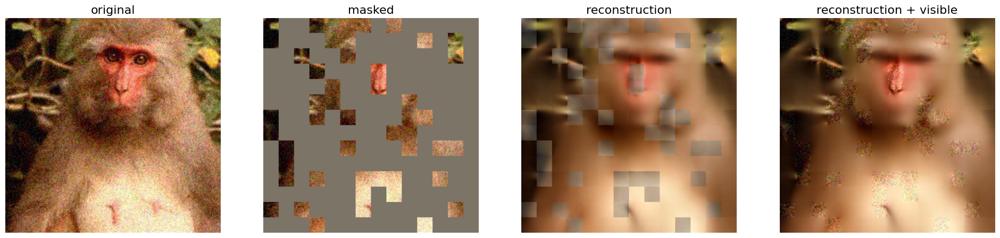

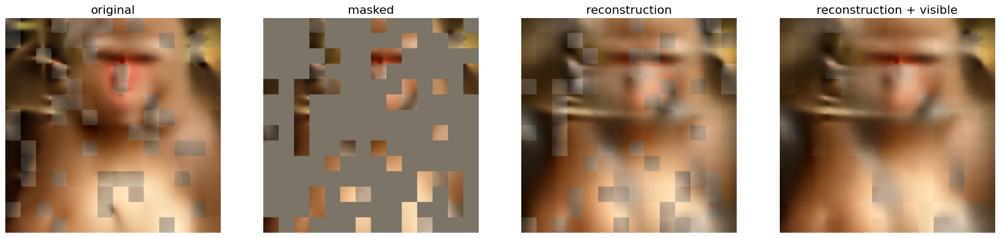

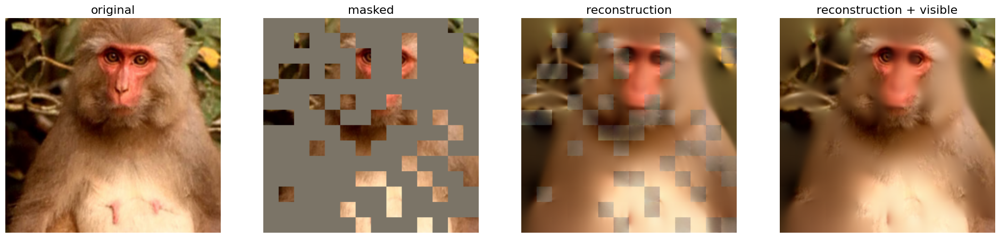

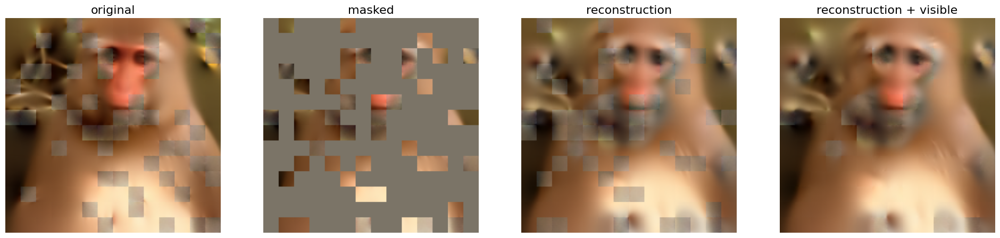

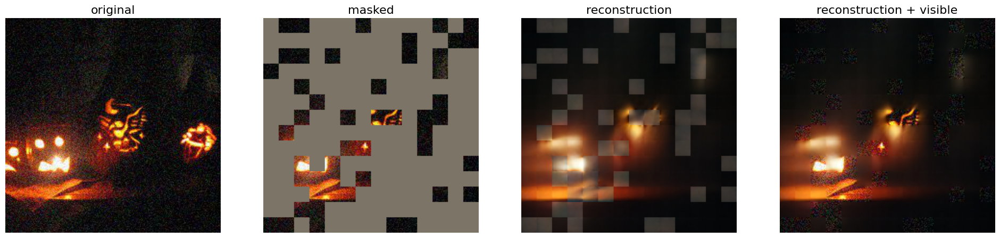

...

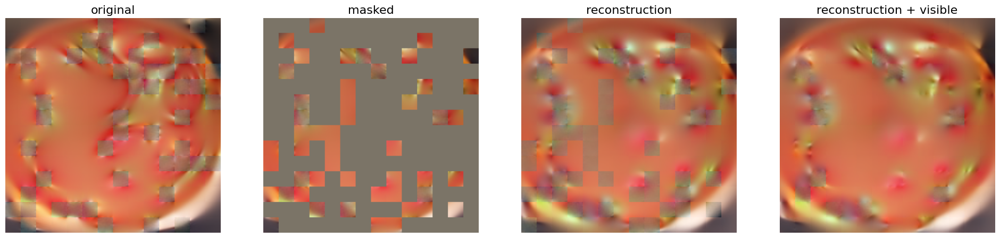

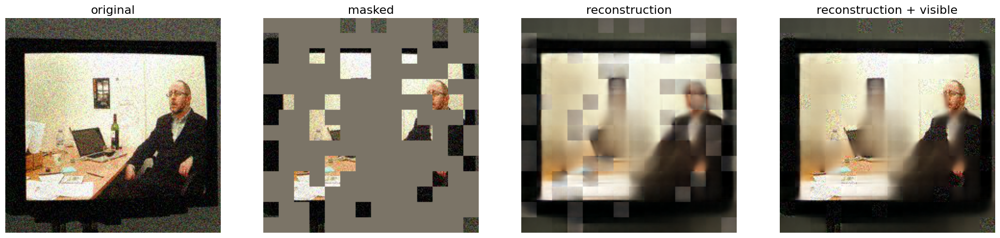

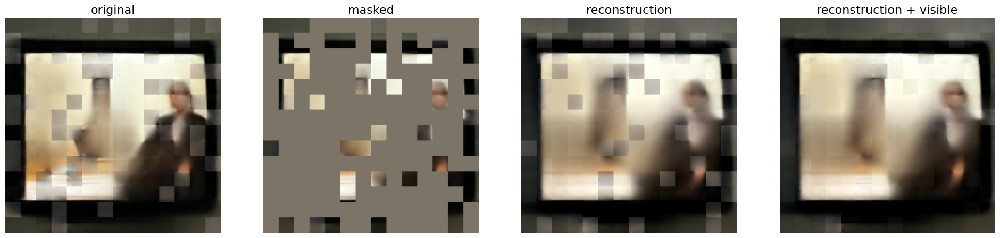

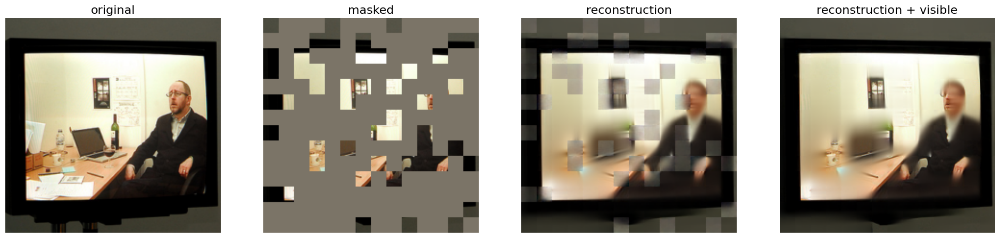

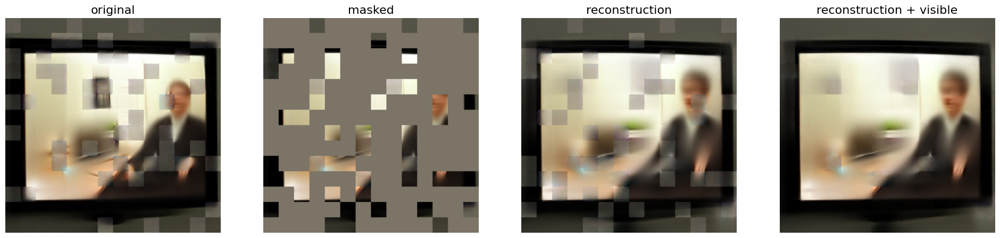

In [12]:
# Here all the masks are different since the noise is randomly generated for every pass
model.eval()

test_x, test_y = next(iter(test_dataloader))    #test_dataloader

model.to("cpu")

og = ViTMAEForPreTraining.from_pretrained('facebook/vit-mae-base') # original

for i in range(8):
  img = visualize(test_x.pixel_values[i], model, ) # First pass through Noisy images with Fine-tuned model
  visualize(img, model, ) # Second pass through Noisy images with Fine-tuned model
  img = visualize(test_y.pixel_values[i], og) # First pass through Clean images with Baseline model
  visualize(img, og) # Second pass through Clean images with Fine-tuned model

In [13]:
# Does not take the masking into account
def image_loss(inputs, clean_, model):
  outputs = model(inputs) # dictionary w/ loss, logits, mask, ids_restore
  return model.forward_loss(clean_, outputs["logits"], outputs["mask"]).cpu().detach().numpy()

In [14]:
# og = ViTMAEForPreTraining.from_pretrained('facebook/vit-mae-base') # original baseline model

In [15]:
noise_loss = []
base_loss = []
base_on_noise_loss = []


device = torch.device("cuda") 


og.eval()
og.to(device)
model.eval()
model.to(device)

for i, (test_x, test_y) in enumerate(test_dataloader):

  batch_size = test_x.pixel_values.size()[0] # should be 8 unless at the very end of the dataloader

  inputs = test_x.pixel_values.view(batch_size,3,224,224).to(device)

  clean_ = test_y.pixel_values.view(batch_size,3,224,224).to(device)

  noise_loss.append(image_loss(inputs, clean_, model))
  base_loss.append(image_loss(clean_, clean_, og))
  base_on_noise_loss.append(image_loss(inputs, clean_, og))
  
  if i % 50 == 0: print(i)
  


0
50


In [16]:
import numpy as np
np.mean(base_loss), np.mean(noise_loss), np.mean(base_on_noise_loss)

(0.24104512, 0.27300686, 0.27335638)

In [17]:
def custom_forward(x, model, noise=None, viz=True):
  # x = x.unsqueeze(dim=0)
  # x = torch.einsum('nhwc->nchw', x)
  outs = model(x, noise)
  loss = outs["loss"]
  y = outs["logits"]
  mask = outs["mask"]
  # print(y.shape, mask.shape, loss.shape)
  y_ = model.unpatchify(y)
  y = torch.einsum('nchw->nhwc', y_).detach().cpu()

  if viz:

    # visualize the mask
    mask = mask.detach()
    # mask.shape
    mask = mask.unsqueeze(-1).repeat(1, 1, 16**2 *3)  # (N, H*W, p*p*3)
    mask = model.unpatchify(mask)  # 1 is removing, 0 is keeping
    mask = torch.einsum('nchw->nhwc', mask).detach().cpu()

    x = torch.einsum('nchw->nhwc', x)

    # masked image
    im_masked = x * (1 - mask)

    # MAE reconstruction pasted with visible patches
    im_paste = x * (1 - mask) + y * mask

    # make the plt figure larger
    plt.rcParams['figure.figsize'] = [24, 24]

    plt.subplot(1, 4, 1)
    show_image(x[0], "original")

    plt.subplot(1, 4, 2)
    show_image(im_masked[0], "masked")

    plt.subplot(1, 4, 3)
    show_image(y[0], "reconstruction")

    plt.subplot(1, 4, 4)
    show_image(im_paste[0], "reconstruction + visible")
    plt.show()

  return y_

In [18]:
import torch 

batch_size = 1
seq_length = 196 
noise = torch.rand(batch_size, seq_length, device=device)
# You can create a noise vector for each pair of (gaussian, clean) either 
# individually or in batches. The x, im_masked, y and im_paste are same as that 
# in visualize() with the only difference that now they'll have an additional batch dimension

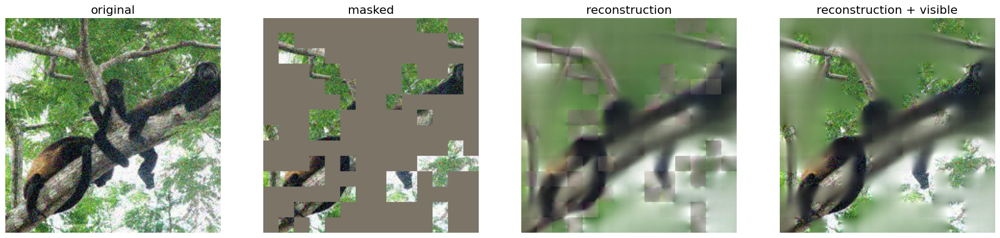

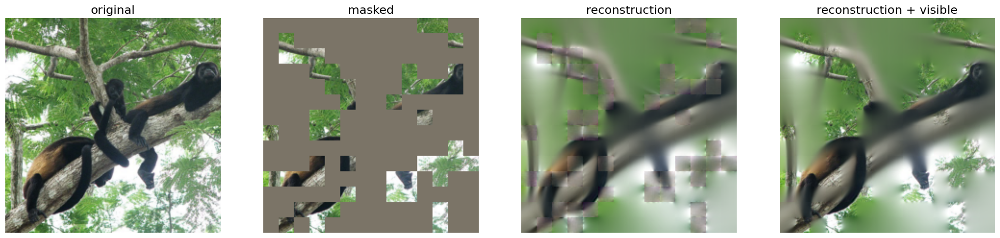

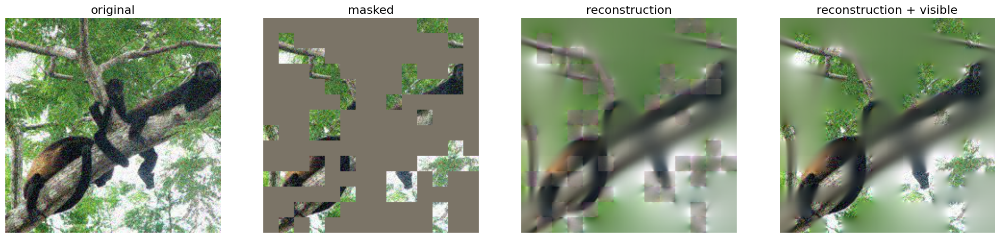

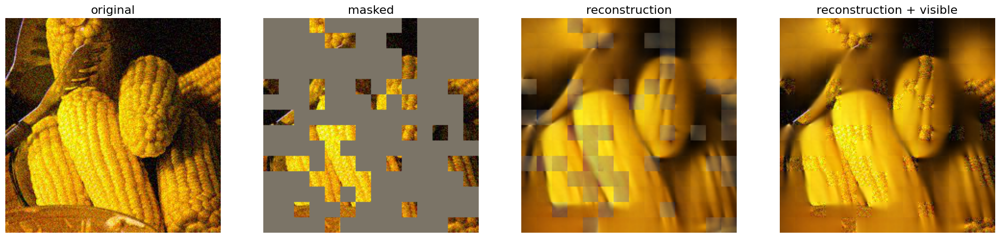

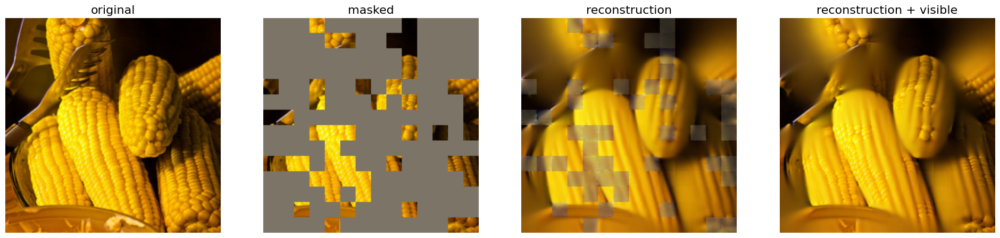

...

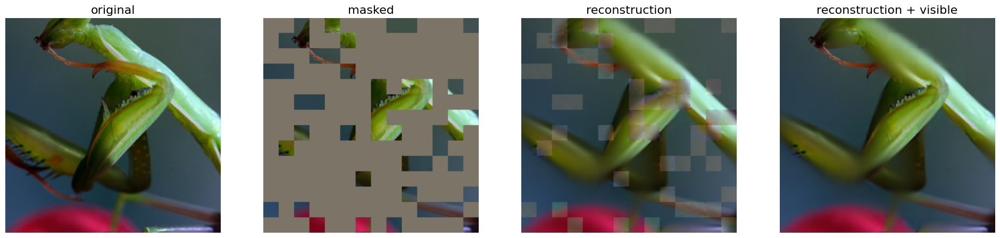

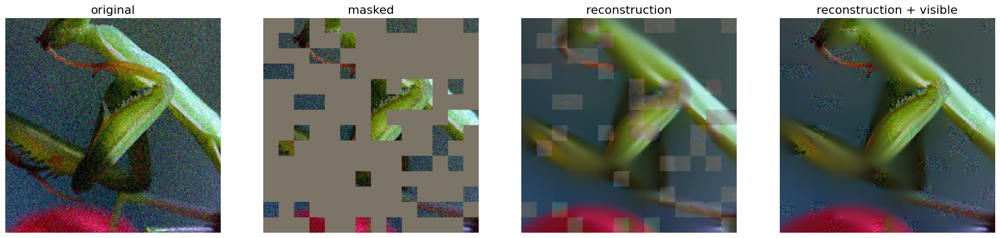

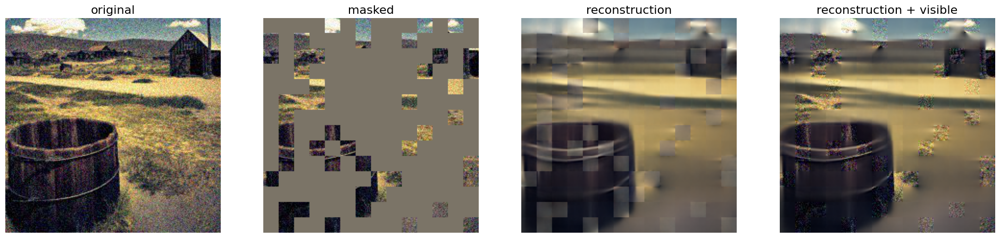

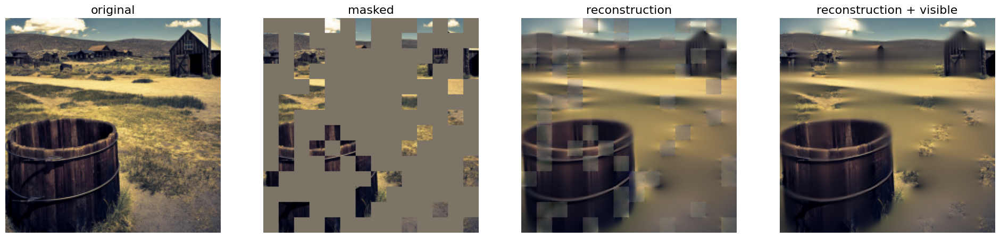

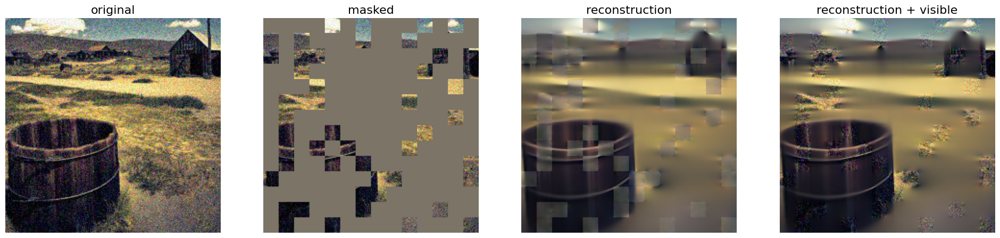

In [65]:
# Here all the masks are same since the noise is reused for every pass
model.eval()

test_x, test_y = next(iter(test_dataloader))   

model.to("cpu")

og = ViTMAEForPreTraining.from_pretrained('facebook/vit-mae-base') # original

for i in range(8):
  noise = torch.rand(batch_size, seq_length, device='cpu')
  img = custom_forward(test_x.pixel_values[i], model, noise)
  img = custom_forward(test_y.pixel_values[i], og, noise)
  img = custom_forward(test_x.pixel_values[i], og, noise)


In [81]:
def custom_image_loss(inputs, clean_, model, noise):
  outputs = model(inputs, noise) # dictionary w/ loss, logits, mask, ids_restore
  return model.forward_loss(clean_, outputs["logits"], outputs["mask"]).cpu().detach().numpy()

In [82]:
noise_loss = []
base_loss = []
base_on_noise_loss = []


device = torch.device("cuda") 


og.eval()
og.to(device)
model.eval()
model.to(device)

for i, (test_x, test_y) in enumerate(test_dataloader):

  batch_size = test_x.pixel_values.size()[0] # should be 8 unless at the very end of the dataloader

  noise = torch.rand(batch_size, seq_length, device=device)

  inputs = test_x.pixel_values.view(batch_size,3,224,224).to(device)

  clean_ = test_y.pixel_values.view(batch_size,3,224,224).to(device)


  noise_loss.append(custom_image_loss(inputs, clean_, model, noise))
  base_loss.append(custom_image_loss(clean_, clean_, og, noise))
  base_on_noise_loss.append(custom_image_loss(inputs, clean_, og, noise))
  
  if i % 50 == 0: print(i)
  


0


In [83]:
import numpy as np
np.mean(base_loss), np.mean(noise_loss), np.mean(base_on_noise_loss)

(0.23480502, 0.26031783, 1.1758872)

In [ ]:
# save noisy reconstructions

model.eval()
device = "cpu"
model.to(device)

first_pass = []
second_pass = [] 

seq_length=196

stop = 1000


for i, (test_x, test_y) in enumerate(train_dataloader):
  batch_size = test_x.pixel_values.size()[0]

  noise = torch.rand(batch_size, seq_length, device=device)

  inputs = test_x.pixel_values.view(batch_size,3,224,224).to(device)

  rec_1 = custom_forward(inputs, model, noise, viz=False)

  # rec_2 = custom_forward(rec_1.view(batch_size, 3, 224, 224), model, noise, viz=False)

  first_pass.append(rec_1)
  # second_pass.append(rec_2)



In [ ]:
len(first_pass)

8

In [ ]:
import pickle as pkl
fileObject = open("/content/drive/MyDrive/566 Project/data/recon_1.pkl", 'wb')
pkl.dump(first_pass, fileObject)
fileObject.close()

fileObject = open("/content/drive/MyDrive/566 Project/data/recon_2.pkl", 'wb')
pkl.dump(second_pass, fileObject)
fileObject.close()

In [ ]:
del train_dataloader